In [1]:
import numba as nb
import numpy as np 
import matplotlib.pyplot as plt
import matplotlib.animation
import math
from matplotlib.patches import CirclePolygon

/home/marcello/anaconda3/lib/python3.9/site-packages/numpy/_core/getlimits.py:545: UserWarning: Signature b'\x00\xd0\xcc\xcc\xcc\xcc\xcc\xcc\xfb\xbf\x00\x00\x00\x00\x00\x00' for <class 'numpy.longdouble'> does not match any known type: falling back to type probe function.
This warnings indicates broken support for the dtype!
  machar = _get_machar(dtype)


In [2]:
@nb.njit(fastmath=True,cache=True)
def LJ( i, j, co2, pos, typ, cell, F ):
    
    E = 0.
    
    ti = typ[i]
    tj = typ[j]
    Eij = co2[ti][tj][0]
    sij = co2[ti][tj][1]
    sij2 = co2[ti][tj][2]
    
    rij = pos[i]-pos[j]
    
    if ( rij[0] > cell[0] ): # cell[0] = Lx/2
        rij[0] -= cell[1]    # cell[1] = Lx
    elif ( rij[0] < -cell[0] ):
        rij[0] += cell[1]
        
    if ( rij[1] > cell[2] ):
        rij[1] -= cell[3]
    elif ( rij[1] < -cell[2] ):
        rij[1] += cell[3]
    
    r2 = rij[0]*rij[0] + rij[1]*rij[1]
    
    if r2 > 0.:
        ir = 1. / np.sqrt(r2)
        rs = sij*ir
        rs2 = rs*rs
        rs6 = rs2*rs2*rs2
        rs12 = rs6*rs6
#        E = 4.*Eij*( (rs12) - (rs6) )
        F = 24.*Eij*ir * ( 2.*(rs12) - (rs6) ) * rij
    return F
#    return E,F,rij

@nb.njit(parallel=True, fastmath=True)
def compute_acc( N, co2, pos, typ, mas, acc, cell, ordered_idx, nat, off, Nx, Ny, bin_of_idx  ):
        
    F = np.zeros(D)
    
    for i in nb.prange(N):
        acc[i] = 0.

    for i in nb.prange(N):
        bin_xy = bin_of_idx[i]
        bin_y_idx = bin_xy % Ny
        bin_x_idx = (bin_xy - bin_y_idx) // Ny
        for other_bin_x in range( bin_x_idx-1,bin_x_idx+2 ):
            for other_bin_y in range( bin_y_idx-1,bin_y_idx+2 ):

                if other_bin_x == -1:
                    other_bin_x = Nx-1
                elif other_bin_x == Nx:
                    other_bin_x = 0
                if other_bin_y == -1:
                    other_bin_y = Ny-1
                elif other_bin_y == Ny:
                    other_bin_y = 0

                n_atom_in_other_bin = nat[other_bin_x][other_bin_y]
                fist_atom_in_other_bin = off[other_bin_x][other_bin_y]

                for j_idx in range(n_atom_in_other_bin):
                    j = ordered_idx[ fist_atom_in_other_bin + j_idx ]
                    if ( i < j ):
                        Fij = LJ( i, j, co2, pos, typ, cell, F )
                        acc[i] += Fij
                        acc[j] -= Fij

    for i in nb.prange(N):
        acc[i] = acc[i] * mas[i]
    
    return acc

@nb.njit(parallel=True, fastmath=True)
def pbc( N, pos, cell ):
    for i in nb.prange(N):
        if pos[i,0] > cell[1]:
            pos[i,0] -= cell[1]
        elif pos[i,0] < 0:
            pos[i,0] += cell[1]
        if pos[i,1] > cell[3]:
            pos[i,1] -= cell[3]
        elif pos[i,1] < 0:
            pos[i,1] += cell[3]
    return pos

@nb.njit(parallel=True, fastmath=True)
def limit_acc( N, acc, dt ):
    max_acc_norm2 = ( 0.1/dt )**2
    for i in nb.prange(N):
        acc_norm2 = acc[i,0]*acc[i,0] + acc[i,1]*acc[i,1]
        if acc_norm2 > max_acc_norm2 :
            fac = np.sqrt(max_acc_norm2 / acc_norm2)
            acc[i,0] *= fac
            acc[i,1] *= fac
    return acc

@nb.njit(parallel=True, fastmath=True)
def center_acc( N, acc ):
    ave_acc = np.sum(acc,axis=0) / N
    for i in nb.prange(N):
        acc[i] -= ave_acc[0]
    return acc

@nb.njit(parallel=True, fastmath=True)
def limit_vel( N, vel, dt ):
    max_vel_norm2 = ( 0.1/dt )**2
    for i in nb.prange(N):
        vel_norm2 = vel[i,0]*vel[i,0] + vel[i,1]*vel[i,1]
        if vel_norm2 > max_vel_norm2 :
            fac = np.sqrt(max_vel_norm2 / vel_norm2)
            vel[i,0] *= fac
            vel[i,1] *= fac
    return vel

@nb.njit(parallel=True, fastmath=True)
def center_vel( N, vel ):
    ave_vel = np.sum(vel,axis=0) / N
    for i in nb.prange(N):
        vel[i] -= ave_vel[0]
    return vel

@nb.njit(parallel=True, fastmath=True)
def balance_vel( N, vel, mas, desired_ave_ken ):
    
    sum_mas_vel2 = 0;
    for i in nb.prange(N):
        sum_mas_vel2 += mas[i]* (vel[i,0]*vel[i,0] + vel[i,1]*vel[i,1])
    
    ave_ken = 0.5 * sum_mas_vel2 / N
    fac = np.sqrt(desired_ave_ken/ave_ken)
    for i in nb.prange(N):
        vel[i] *= fac

    return ave_ken

import itertools

def flatten_list(nested_list):
    return list(itertools.chain(*nested_list))



def find_interacting( N, pos, typ, cell, cutoff ):
    
    Lx = cell[1]
    Ly = cell[3]
    Nx = math.ceil(Lx / cutoff)
    Ny = math.ceil(Ly / cutoff)

    binned_idx = [ [ [] for i in range(Ny) ] for j in range(Nx) ]
    off = []
    nat = []
    
    
    bin_of_idx = np.zeros( N, dtype=int )
    for i in range(N):
        bin_x = math.floor (pos[i,0] / Lx * Nx)
        bin_y = math.floor (pos[i,1] / Ly * Ny)
        if bin_x >= Nx:
            print ( pos[i,0], Lx, bin_x, pos[i,0] / Lx * Nx )
        if bin_y >= Ny:
            print ( pos[i,1], Ly, bin_y, pos[i,1] / Ly * Ny )

        binned_idx[bin_x][bin_y].append(i)
        bin_of_idx[i] = bin_x * Ny + bin_y

    ordered_idx = flatten_list(flatten_list(binned_idx))
    
    tot_idx = 0
    for bin_x in range(Nx):
        for bin_y in range(Ny):
            n_idx = len(binned_idx[bin_x][bin_y])
            off.append( tot_idx )
            nat.append( n_idx )
            tot_idx += n_idx
    
    ordered_idx = np.array(ordered_idx)
    nat = np.array(nat).reshape((Nx,Ny))
    off = np.array(off).reshape((Nx,Ny))
    return ordered_idx, nat, off, Nx, Ny, bin_of_idx


In [3]:
@nb.njit(parallel=True)
def vV( N, pos, vel, acc, mas, typ, dt, cell, target_T, ordered_idx, nat, off, Nx, Ny, bin_of_idx ):

    for i in nb.prange(N):
        pos[i] += vel[i]*dt + 0.5*acc[i]*dt*dt
    
    pos = pbc(N, pos,cell)
    
    for i in nb.prange(N):
        vel[i] += 0.5*acc[i]*dt
    
    acc = compute_acc( N, co2, pos, typ, mas, acc, cell, ordered_idx, nat, off, Nx, Ny, bin_of_idx  )
    
    acc = limit_acc( N, acc, dt )
    acc = center_acc( N, acc )
    
    for i in nb.prange(N):
        vel[i] += 0.5*acc[i]*dt
    
    
    
    vel = limit_vel( N, vel, dt )
    vel = center_vel( N, vel )
    T = balance_vel( N, vel , mas, target_T )
    

In [4]:
@nb.njit()
def find_nonoverlapping_circles( typ, co1, N,D, cell, pos ):
    pos = np.zeros(shape=(N,D))
    
    Lx = cell[1]
    Ly = cell[3]
    
    tent = 0
    for i in range(N):
        while True:
            pos[i] = np.random.random(2)
            pos[i,0] *= Lx
            pos[i,1] *= Ly

            overlap = False
            min_drR = Lx + Ly
            disp_x = 0.0 
            disp_y = 0.0 
            for j in range(i):
                ti = typ[i]
                tj = typ[j]

                Ri = co1[ti][1]
                Rj = co1[tj][1]
                rij = pos[i]-pos[j]
                if ( rij[0] > cell[0] ): # cell[0] = Lx/2
                    rij[0] -= cell[1]    # cell[1] = Lx
                elif ( rij[0] < -cell[0] ):
                    rij[0] += cell[1]

                if ( rij[1] > cell[2] ):
                    rij[1] -= cell[3]
                elif ( rij[1] < -cell[2] ):
                    rij[1] += cell[3]
                d = np.sqrt( rij[0]*rij[0] + rij[1]*rij[1] )
                
                if d < (Ri + Rj):
                    overlap = True
                    break
                
                if d - Ri - Rj < min_drR:
                    min_drR = d - Ri - Rj
                    disp_x = rij[0] * (d-Ri-Rj) / d
                    disp_y = rij[1] * (d-Ri-Rj) / d
                
            tent += 1
            if tent % 1024 == 0:
                print(i,tent)
                
            if overlap == False:
                pos[i,0] -= disp_x
                pos[i,1] -= disp_y
                pos = pbc(N, pos,cell)
                break

    return pos
    
    


864 1024
1506 2048
2136 3072
2799 4096
3439 5120
4087 6144
4680 7168
5279 8192
5860 9216
6421 10240
6978 11264
7518 12288
8026 13312
8534 14336
8997 15360
9428 16384
9868 17408
10309 18432
10733 19456
11136 20480
11531 21504
11945 22528
12306 23552
12672 24576
13024 25600
13385 26624
13742 27648
14077 28672
14370 29696
14671 30720
14964 31744
15268 32768
15554 33792
15847 34816
16105 35840
16370 36864
(16384, 2)


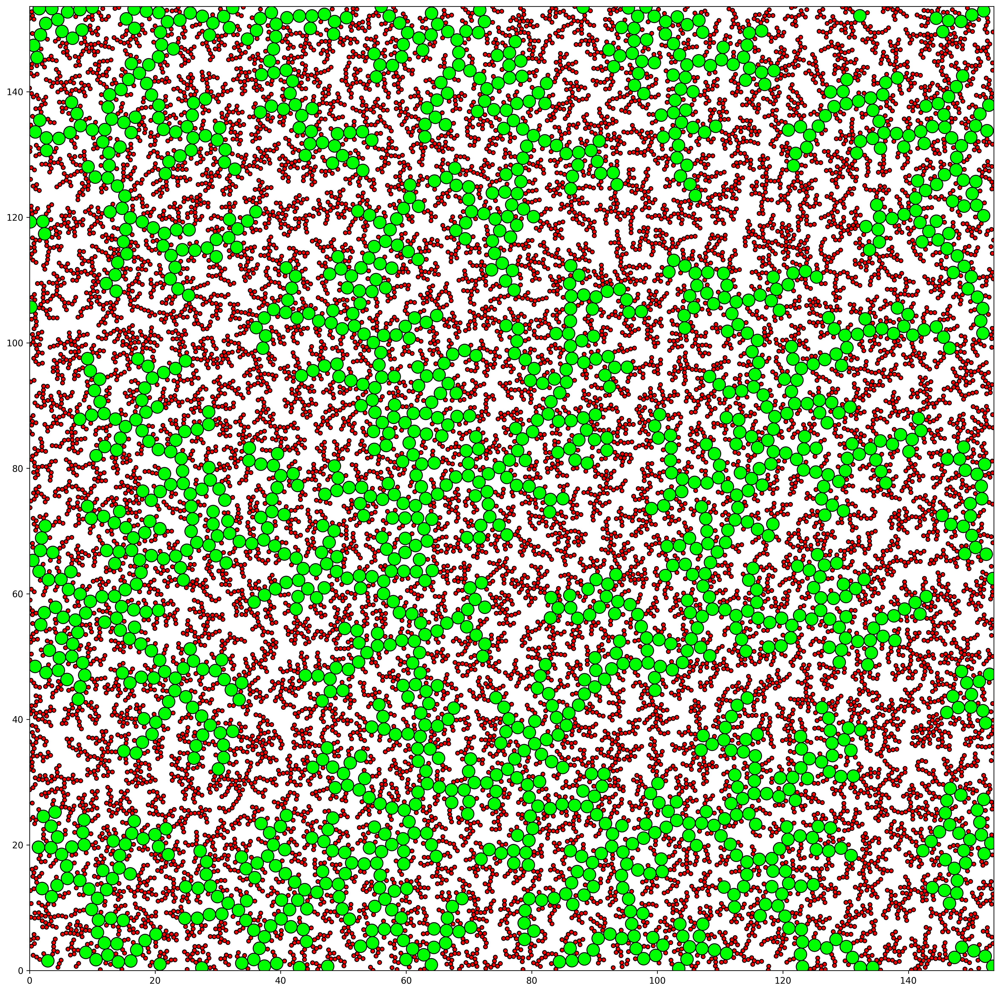

In [17]:
N = 1024*16
D = 2
dt = 0.01
L = 1.2*(N**(1./D))
cell = np.array([L/2.,L,L/2.,L])

kinds = [0,1]
mass_of_type = [1.,10.]


# Energy of the LJ
Ea = 1.
Eb = 1.
# Radius
Ra = 0.31
Rb = 1.

co1 = [
    [Ea,Ra],
    [Eb,Rb]]
co1 = np.array(co1)
co1 = co1.reshape(2,2)

co2 = []
for t1 in co1:
    for t2 in co1:
        E1 = t1[0]
        E2 = t2[0]
        R1 = t1[1]
        R2 = t2[1]
        E12 = np.sqrt(E1*E2)
        R12 = (R1+R2)
        co2.append([E12,R12,R12*R12])
co2 = np.array(co2)
co2 = co2.reshape(2,2,3)

pos = np.zeros(shape=(N,D))
vel = np.zeros(shape=(N,D))
acc = np.zeros(shape=(N,D))


typ = np.random.choice( kinds, N, True, [0.9,0.1] )
# sort by radius, larger first
#rad = [co1[t][1] for t in typ]
typ = np.array(sorted(typ, reverse=True))
pos = find_nonoverlapping_circles( typ, co1, N,D, cell, pos )

vel = np.random.random( vel.shape )
vel = vel - 0.5
vel = vel * 2.

mas = np.array([mass_of_type[t] for t in typ ])

size_of_type = [Ra, Rb ]
siz = np.array([size_of_type[t] for t in typ ])

print(pos.shape)

circle_fill_color = np.array([[1.0,0.0,0.0,1.0],[0.0,1.0,0.0,1.0]])
circle_brdr_color = np.array([[0.0,0.0,0.0,1.0],[0.0,0.0,0.0,1.0]])

draw_list = []
for i in range(N):
    draw_list.append(CirclePolygon((pos[i,0], pos[i,1]), siz[i], resolution=28, color=circle_fill_color[typ[i]], fill=True))
    draw_list.append(CirclePolygon((pos[i,0], pos[i,1]), siz[i], resolution=28, color=circle_brdr_color[typ[i]], fill=False))

fig = plt.figure(figsize=(20,20))
ax = plt.gca()
ax.set_aspect('equal')
ax.set_xlim(0,L)
ax.set_ylim(0,L)

for circle in draw_list:    
    ax.add_artist(circle)



In [6]:
L, pos

(153.6,
 array([[  9.81486867,  45.42492707],
        [  7.93523354,  46.10828041],
        [  6.67126443,  44.55831844],
        ...,
        [119.45319519, 129.12019407],
        [ 38.34052937,  52.45054452],
        [ 46.05786365,  30.73684448]]))

In [18]:
%time find_interacting( N, pos, typ, cell, 5.)
find_interacting( N, pos, typ, cell, 5.)

CPU times: user 0 ns, sys: 0 ns, total: 0 ns
Wall time: 15.2 ms


(array([  976,  2999,  3160, ..., 14610, 16248, 16342]),
 array([[15, 24, 14, 17, 12, 15, 26, 18, 24, 16, 17, 12, 13, 12, 14, 19,
         24, 17, 23, 17, 23, 23, 18, 24, 12, 16, 15, 13, 19, 17, 10],
        [14, 26,  9, 12, 11, 23, 16, 15, 21, 11, 16, 14, 10, 20, 16, 20,
         19, 23, 19, 24, 17, 19, 22, 16, 20, 25, 12, 12, 24, 22,  9],
        [13, 11, 17, 17, 18, 25, 19, 23, 16, 23, 18, 13, 18, 15, 13, 18,
         18, 14,  9, 17, 20, 23, 20, 22, 12, 10, 11, 10, 21, 21, 17],
        [12, 24, 23, 14, 10, 19, 29, 14, 19, 14, 10, 12, 14, 13, 14, 25,
         16, 11, 16, 18, 29, 22, 25, 17, 18, 21, 17, 15,  9, 15, 13],
        [14, 19, 22, 25, 19, 18, 18, 19, 11, 15, 11, 19, 21, 11, 15, 11,
          8, 17, 23,  8, 26, 19, 15,  9, 20, 25, 15, 16, 18, 17, 16],
        [22, 17, 11, 17, 19, 24, 19, 15, 17, 15, 20, 23, 22, 13, 11,  7,
         16, 13, 22, 22, 19, 24, 17,  8, 25, 20, 15, 13, 24, 15, 12],
        [13, 17, 17, 20, 22, 22, 21, 20, 11, 14, 17, 18, 19, 14, 12, 12,
         23,

In [22]:
all_pos = []
all_vel = []
all_acc = []
tmp_acc2 = np.zeros((N,N,D))
t = 0
for ot in range(10):
    target_T = 0.1 + 1.5 * np.sin( t * np.pi / 100 )**2
    for it in range(10):
        ordered_idx, nat, off, Nx, Ny, bin_of_idx = find_interacting( N, pos, typ, cell, 5. )        
        if t % 24 == 0 :
            %time vV( N, pos, vel, acc, mas, typ, dt, cell, target_T, ordered_idx, nat, off, Nx, Ny, bin_of_idx )
        else:
            vV( N, pos, vel, acc, mas, typ, dt, cell, target_T, ordered_idx, nat, off, Nx, Ny, bin_of_idx )
        t += 1
    all_pos.append(np.copy(pos))
    all_vel.append(np.copy(vel))
    all_acc.append(np.copy(acc))

CPU times: user 219 ms, sys: 15.6 ms, total: 234 ms
Wall time: 46.5 ms
CPU times: user 266 ms, sys: 0 ns, total: 266 ms
Wall time: 51.8 ms
CPU times: user 344 ms, sys: 0 ns, total: 344 ms
Wall time: 53 ms
CPU times: user 375 ms, sys: 0 ns, total: 375 ms
Wall time: 48.4 ms
CPU times: user 281 ms, sys: 0 ns, total: 281 ms
Wall time: 52.8 ms


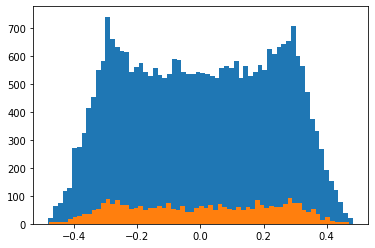

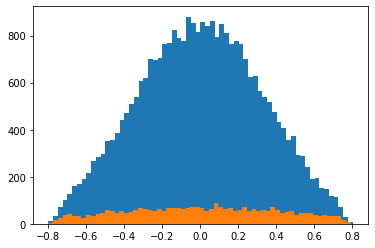

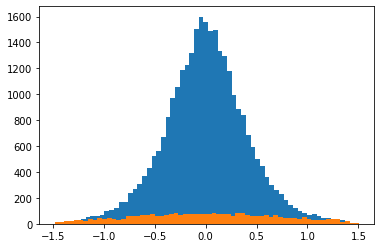

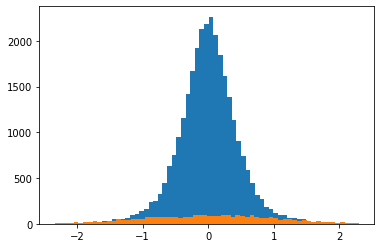

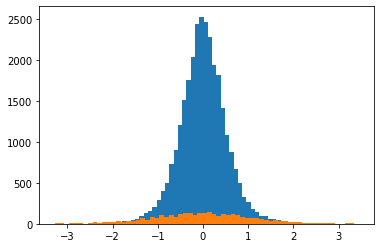

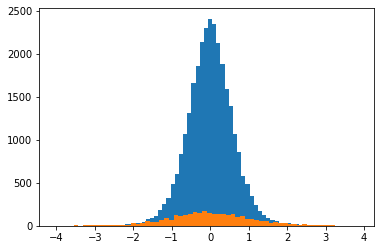

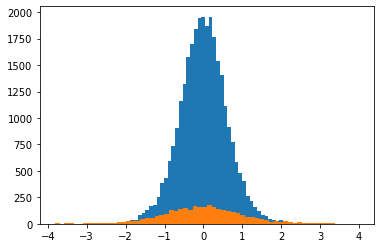

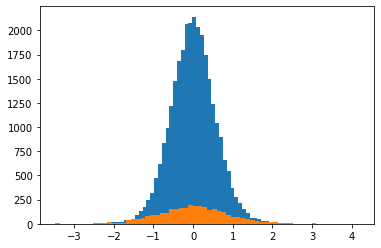

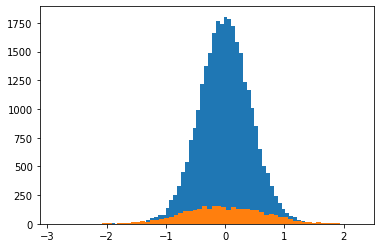

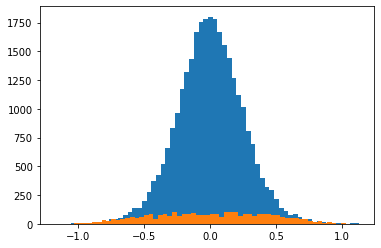

In [9]:
for vel in all_vel:
    for kind in kinds:
        plt.hist(vel[np.where(typ==kind)].flatten(),bins=64)
    plt.show()

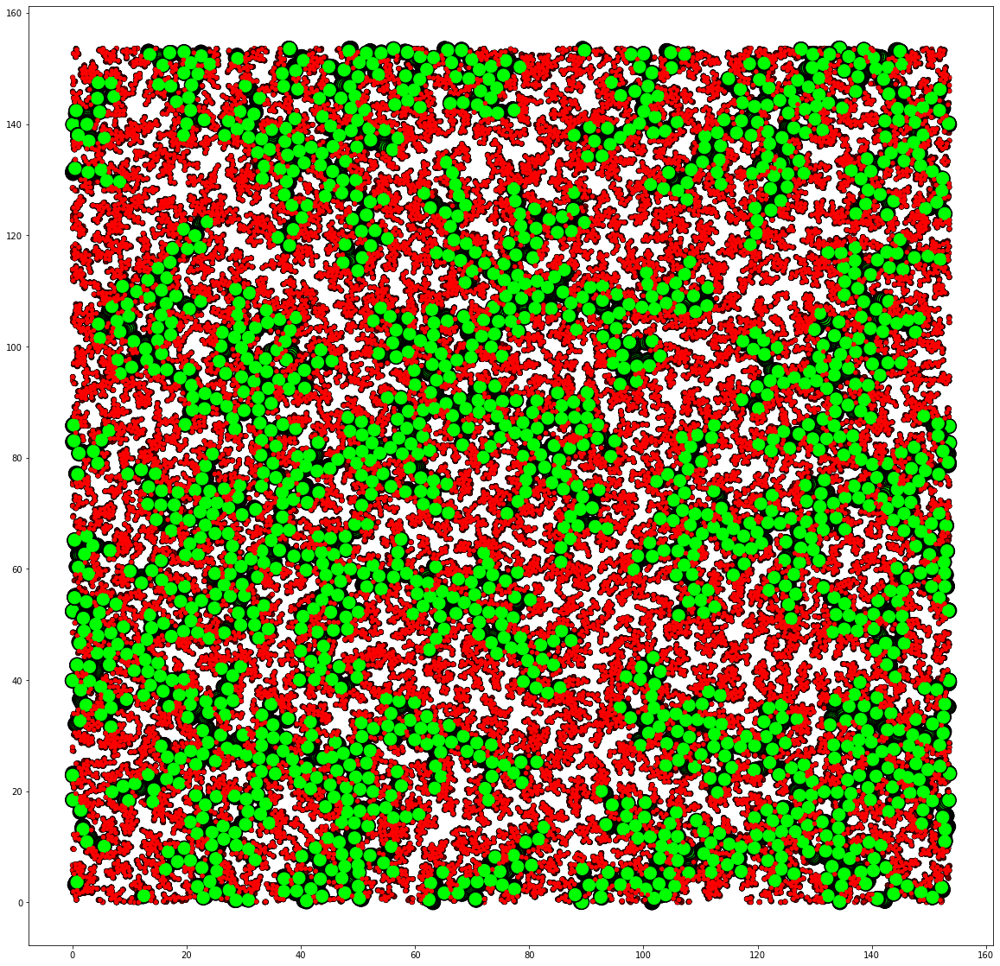

In [10]:
circle_fill_color = np.array([[1.0,0.0,0.0,1.0],[0.0,1.0,0.0,1.0]])
circle_brdr_color = np.array([[0.0,0.0,0.0,1.0],[0.0,0.0,0.0,1.0]])

fig = plt.figure(figsize=(20,20))

for pos in all_pos:
    plt.scatter(pos[:,0], pos[:,1], s=300*siz**2, c=circle_brdr_color[typ])
    plt.scatter(pos[:,0], pos[:,1], s=200*siz**2, c=circle_fill_color[typ])

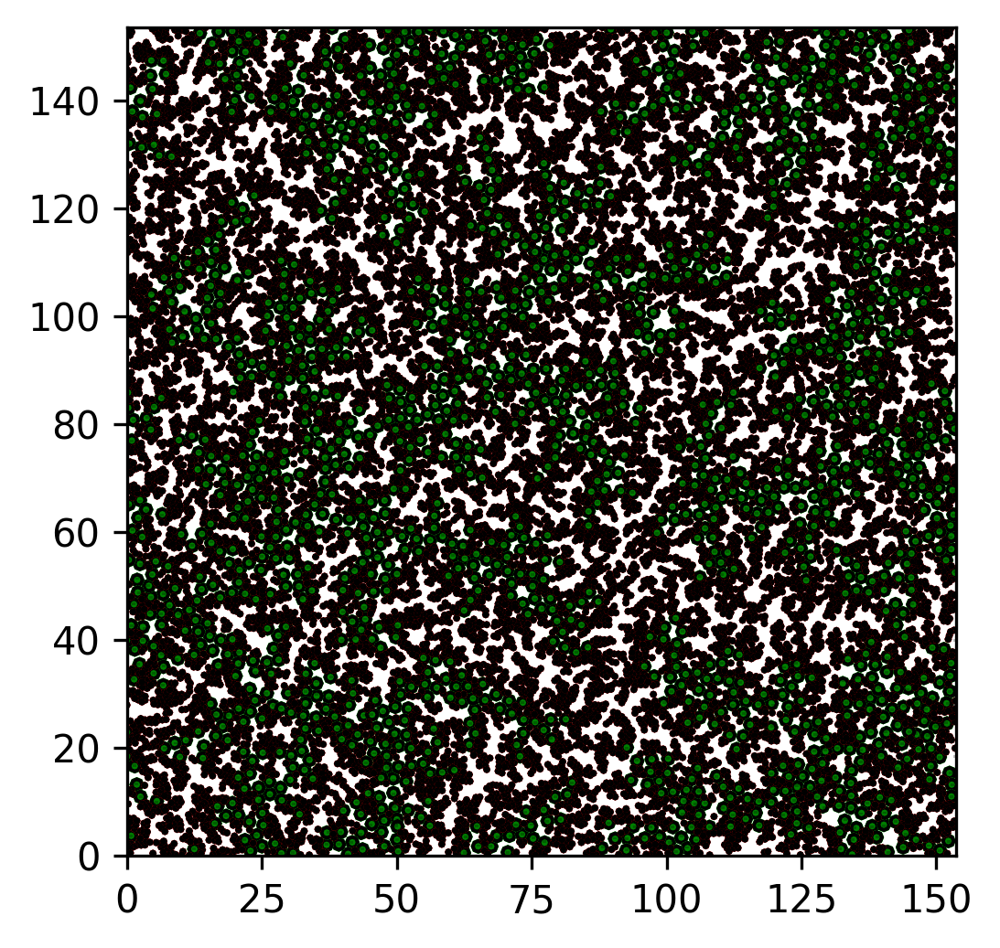

In [11]:
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['animation.embed_limit'] = 2**128
plt.rcParams['figure.dpi'] = 300  
plt.ioff()


circle_fill_color = np.array([[1.0,0.0,0.0,1.0],[0.0,1.0,0.0,1.0]])
circle_brdr_color = np.array([[0.0,0.0,0.0,1.0],[0.0,0.0,0.0,1.0]])


def animate(ot):
    plt.cla()
    pos = all_pos[ot]
    draw_list = []
    for i in range(N):
        draw_list.append(CirclePolygon((pos[i,0], pos[i,1]), siz[i], resolution=8, color=circle_fill_color[typ[i]], fill=True))
        draw_list.append(CirclePolygon((pos[i,0], pos[i,1]), siz[i], resolution=8, color=circle_brdr_color[typ[i]], fill=False))

    Np = 3
    for pt in range(1,Np):
        fac = (Np-pt)/(Np+1)
        if ot-pt > 0 :
            prev_pos = all_pos[ot-pt]
        else:
            prev_pos = all_pos[0]

        for i in range(N):
            draw_list.append(CirclePolygon((prev_pos[i,0], prev_pos[i,1]), siz[i]*fac, resolution=8*fac, color=fac*circle_brdr_color[typ[i]], fill=False))
        
    ax = plt.gca()
    ax.set_aspect('equal')
    ax.set_xlim(0,L)
    ax.set_ylim(0,L)
    for circle in draw_list:    
        ax.add_artist(circle)

fig, ax = plt.subplots()
matplotlib.animation.FuncAnimation(fig, animate, frames=len(all_pos))

In [ ]:
nat.shape[0]

In [16]:
%time vV( N, pos, vel, acc, mas, typ, dt, cell, target_T, ordered_idx, nat, off, Nx, Ny, bin_of_idx )

CPU times: user 438 ms, sys: 15.6 ms, total: 453 ms
Wall time: 57.3 ms
